<a href="https://colab.research.google.com/github/mounishvatti/pothole_detection_yolov8/blob/main/Potholes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Thu Feb 29 06:06:47 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [3]:
!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.3/78.2 GB disk)


In [4]:
from ultralytics import YOLO

from IPython.display import display, Image

In [5]:
%cd {HOME}

/content


In [8]:
%cd {HOME}
!yolo task=detect mode=train model=yolov8m.pt data=/content/drive/MyDrive/PotholeDetectionProjectyolov8/data.yaml epochs=100 imgsz=640

/content
New https://pypi.org/project/ultralytics/8.1.19 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/drive/MyDrive/PotholeDetectionProjectyolov8/data.yaml, epochs=100, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_w

In [9]:
!ls {HOME}//runs/detect/train2

args.yaml					    P_curve.png       train_batch2.jpg
confusion_matrix_normalized.png			    PR_curve.png      train_batch990.jpg
confusion_matrix.png				    R_curve.png       train_batch991.jpg
events.out.tfevents.1709186973.fea1c67a703d.2979.0  results.csv       train_batch992.jpg
F1_curve.png					    results.png       val_batch0_labels.jpg
labels_correlogram.jpg				    train_batch0.jpg  val_batch0_pred.jpg
labels.jpg					    train_batch1.jpg  weights


/content


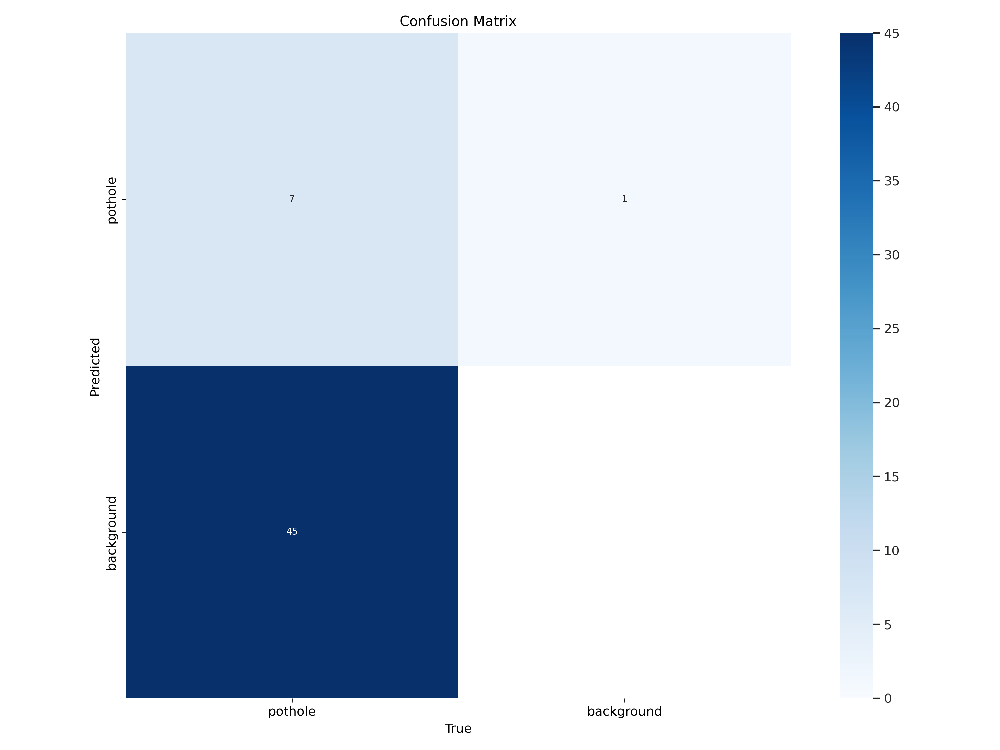

In [10]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train2/confusion_matrix.png', width = 900)

/content


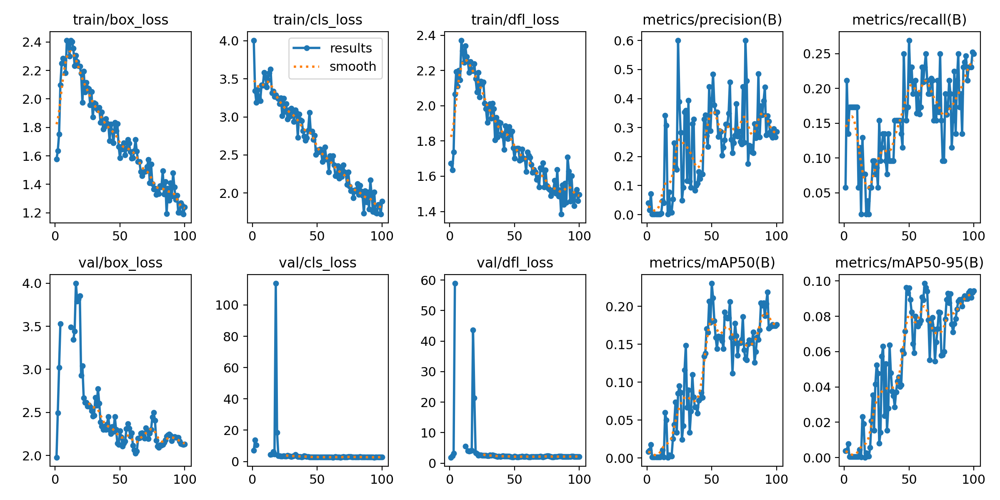

In [11]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train2/results.png', width = 600)

/content


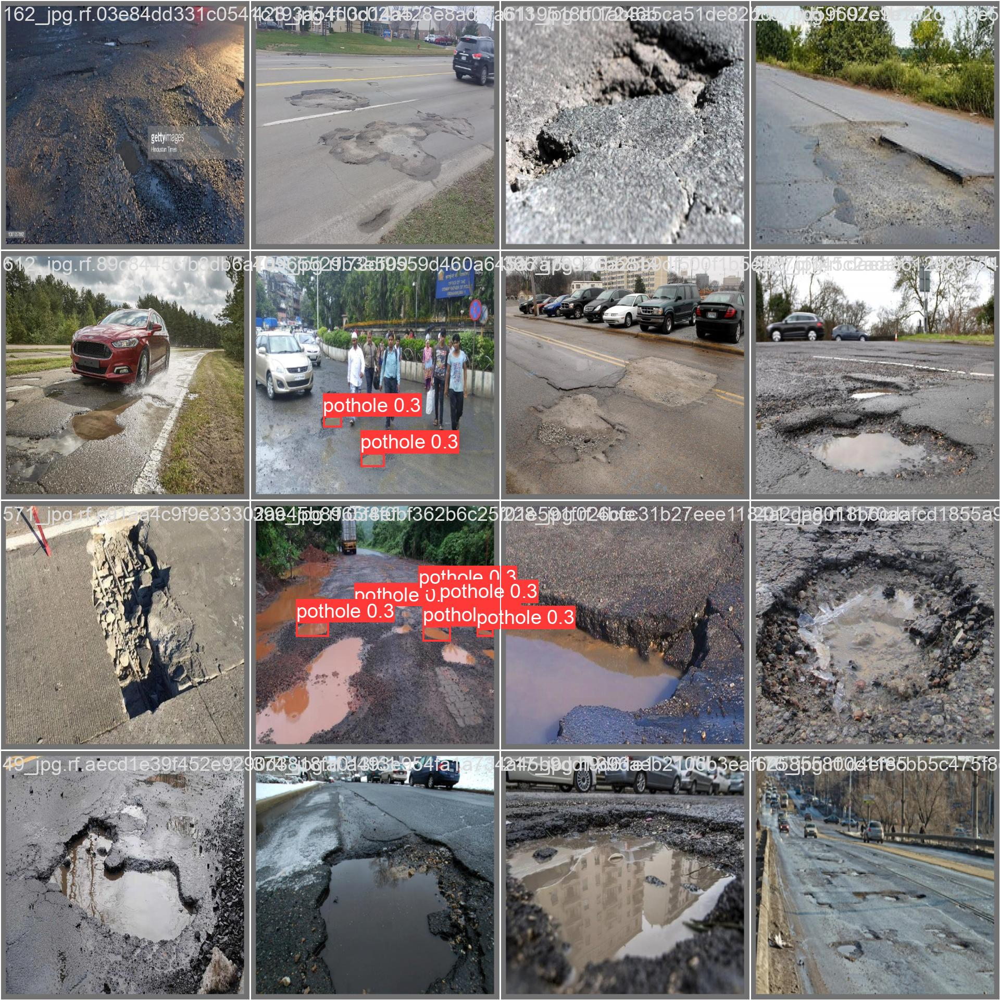

In [12]:
%cd {HOME}

Image(filename = f'{HOME}/runs/detect/train2/val_batch0_pred.jpg', width = 600)

In [13]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train2/weights/best.pt data=/content/drive/MyDrive/PotholeDetectionProjectyolov8/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/drive/MyDrive/PotholeDetectionProjectyolov8/valid/labels.cache... 19 images, 6 backgrounds, 0 corrupt: 100% 19/19 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 2/2 [00:01<00:00,  1.01it/s]
                   all         19         52      0.397      0.269      0.231     0.0982
Speed: 0.3ms preprocess, 45.3ms inference, 0.0ms loss, 33.9ms postprocess per image
Results saved to runs/detect/val
💡 Learn more at https://docs.ultralytics.com/modes/val


In [14]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train2/weights/best.pt conf=0.25 source=/content/drive/MyDrive/PotholeDetectionProjectyolov8/test/images

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

image 1/12 /content/drive/MyDrive/PotholeDetectionProjectyolov8/test/images/164_jpg.rf.49f0276469785d84021662a3a1ee2557.jpg: 640x640 (no detections), 37.1ms
image 2/12 /content/drive/MyDrive/PotholeDetectionProjectyolov8/test/images/188_jpg.rf.d488518d1a11be4c6b1461a8306869c0.jpg: 640x640 (no detections), 37.1ms
image 3/12 /content/drive/MyDrive/PotholeDetectionProjectyolov8/test/images/202_jpg.rf.42043aa60da7e4b4699bed883f292a5a.jpg: 640x640 (no detections), 37.2ms
image 4/12 /content/drive/MyDrive/PotholeDetectionProjectyolov8/test/images/215_jpg.rf.3b949d74f7fc7512ae3d62dc3e92f85a.jpg: 640x640 (no detections), 37.2ms
image 5/12 /content/drive/MyDrive/PotholeDetectionProjectyolov8/test/images/363_jpg.rf.d9310c258f4af9ea630bf346df311caf.jpg: 640x640 1 pothole, 37.1ms
image 6/12 /content/drive/MyDrive/PotholeD

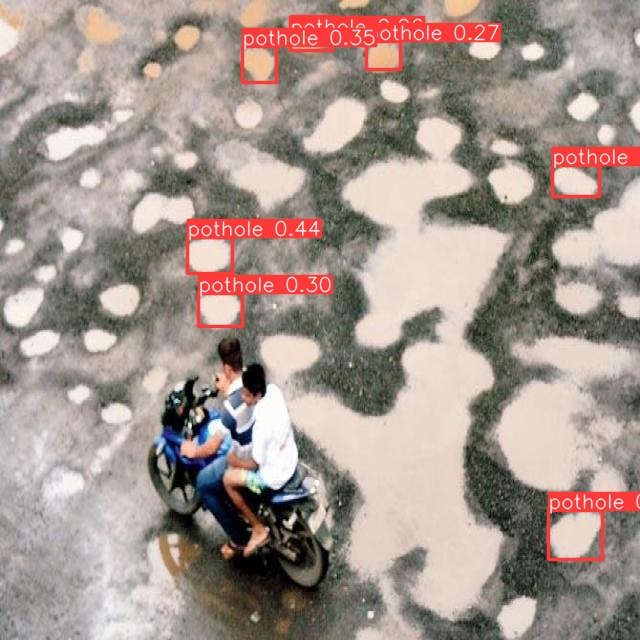

In [15]:
Image('/content/runs/detect/predict/376_jpg.rf.ac0f732a5be0b719ad5319f2517119ce.jpg')

In [16]:
%cd {HOME}

!yolo task=detect mode=predict model={HOME}/runs/detect/train2/weights/best.pt conf=0.25 source='/content/drive/MyDrive/potholesinaruralroad.mp4'

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25840339 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (1/692) /content/drive/MyDrive/potholesinaruralroad.mp4: 384x640 (no detections), 119.1ms
video 1/1 (2/692) /content/drive/MyDrive/potholesinaruralroad.mp4: 384x640 (no detections), 25.7ms
video 1/1 (3/692) /content/drive/MyDrive/potholesinaruralroad.mp4: 384x640 (no detections), 25.1ms
video 1/1 (4/692) /content/drive/MyDrive/potholesinaruralroad.mp4: 384x640 1 pothole, 25.1ms
video 1/1 (5/692) /content/drive/MyDrive/potholesinaruralroad.mp4: 384x640 (no detections), 25.1ms
video 1/1 (6/692) /content/drive/MyDrive/potholesinaruralroad.mp4: 384x640 1 pothole, 25.1ms
video 1/1 (7/692) /content/drive/MyDrive/potholesinaruralroad.mp4: 384x640 1 pothole, 25.1ms
video 1/1 (8/692) /content/drive/MyDrive/potholesinaruralroad.mp4: 384x640 (no detections), 25.1ms
video 1/1 (9/692) /content/drive/MyDrive/potho

In [17]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict2/potholesinaruralroad.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""<video width="640" height="480" controls>
    <source src="{data_url}" type="video/mp4">
</video>""")